In [1]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

from config.config import Config
from src.data_generator import VOCData
from src.visualize import draw_box
from src.model import get_rpn_target, generate_anchors, unparameterize_box, box_iou

# increase image resolution for jupyter notebook
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 150

# load config
config = Config()
config.BATCH_SIZE = 1

# load dataset
train_data_dir = 'dataset/VOC2007/trainval/VOCdevkit/VOC2007'
train_dataset = VOCData(train_data_dir,
                        config.INPUT_SHAPE,
                        batch_size=config.BATCH_SIZE,
                        max_gt_instance=config.MAX_GT_INSTANCE,
                        debug=True)

# generate anchors
anchors = generate_anchors(
    config.ANCHOR_SCALES,
    config.ANCHOR_RATIOS,
    config.FEATURE_SHAPE,
    config.FEATRUE_STRIDE,
    config.ANCHOR_STRIDE
    )

# get one batch data from the dataset
img_batch, (gt_cls_ids, gt_boxes, num_gt_instance) = train_dataset[0]
rpn_targets = tf.map_fn(
    fn=lambda idx: get_rpn_target(
        anchors,
        gt_boxes[idx][:num_gt_instance[idx]],
        # gt_box,
        image_shape=config.INPUT_SHAPE,
        pos_threshold=config.RPN_POS_IOU_THOLD,
        neg_threshold=config.RPN_NEG_IOU_THOLD,
        total_sample_num=config.RPN_TOTAL_SAMPLE_NUM,
        pos_sample_ratio=config.RPN_POS_SAMPLE_RATIO),
    elems=tf.range(config.BATCH_SIZE),
    # elems=num_gt_instance,
    fn_output_signature=(
        tf.TensorSpec(shape=[config.RPN_TOTAL_SAMPLE_NUM], dtype=tf.int32),
        tf.TensorSpec(shape=[config.RPN_TOTAL_SAMPLE_NUM, 4], dtype=tf.float32),
        tf.TensorSpec(shape=[config.RPN_TOTAL_SAMPLE_NUM], dtype=tf.int32),
        tf.TensorSpec(shape=[], dtype=tf.int32),),
    parallel_iterations=config.BATCH_SIZE,
    )

# unpack rpn_targets and make numpy
rpn_cls_target = rpn_targets[0][0].numpy()
rpn_reg_target = rpn_targets[1][0].numpy()
rpn_train_indices = rpn_targets[2][0].numpy()
rpn_pos_num = rpn_targets[3][0].numpy()

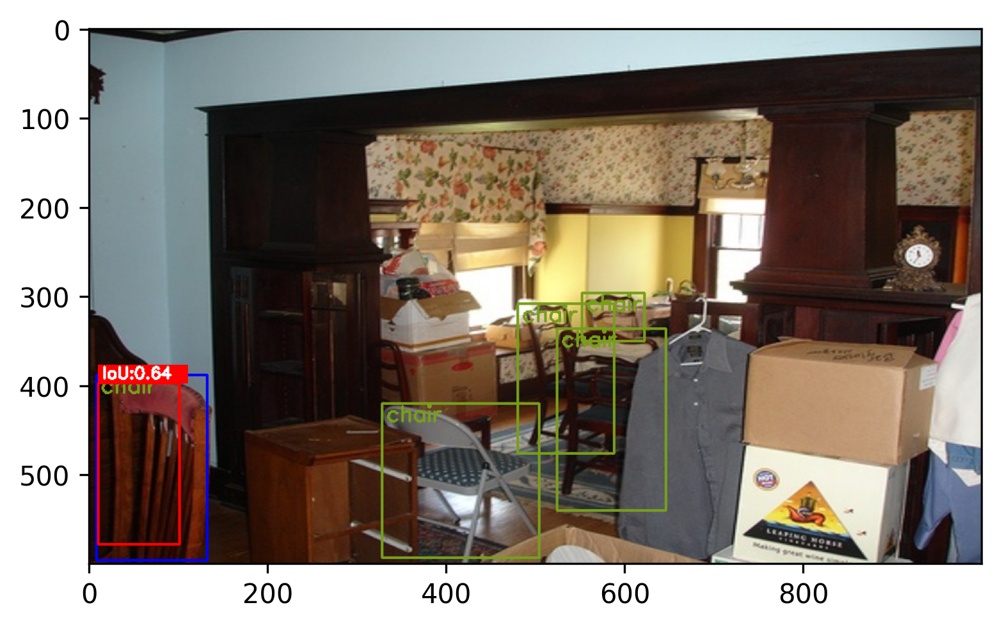

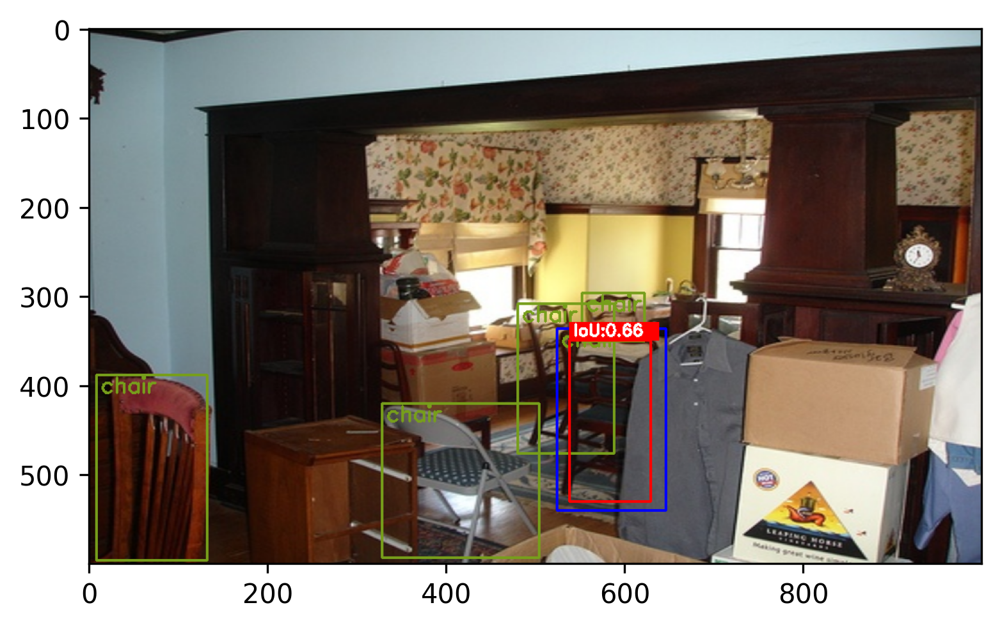

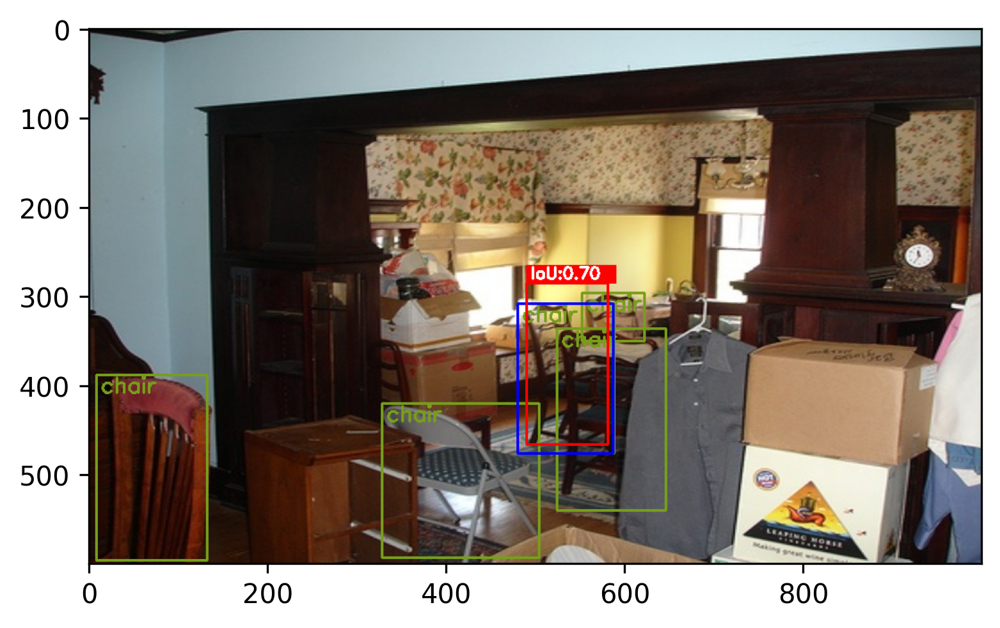

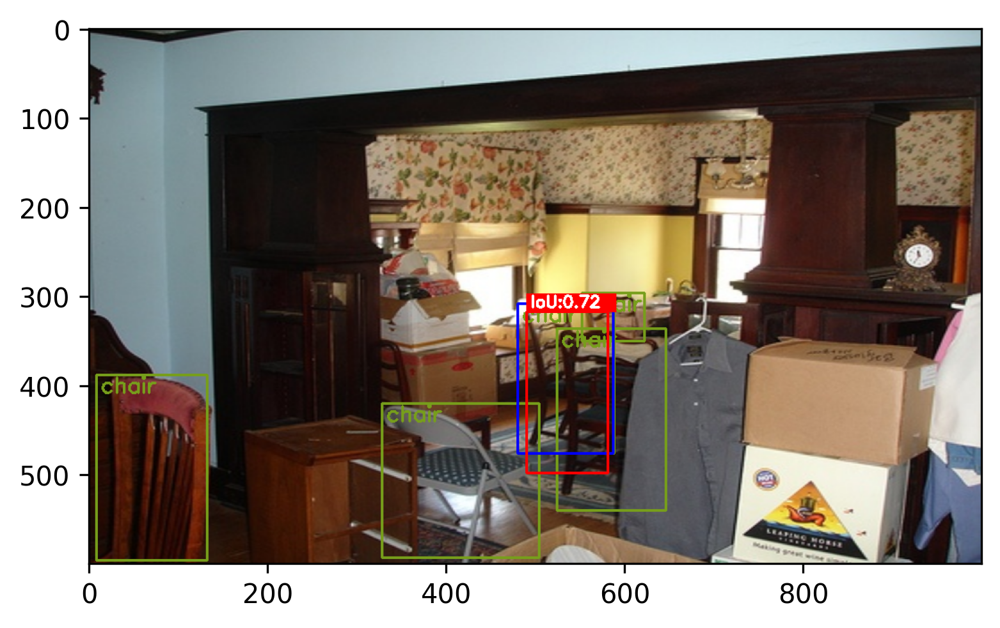

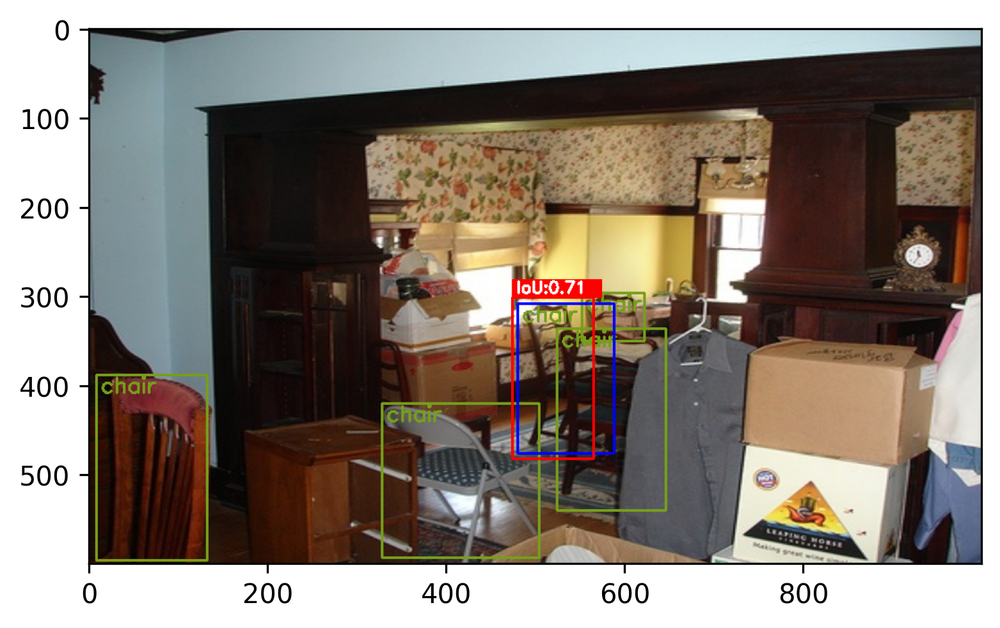

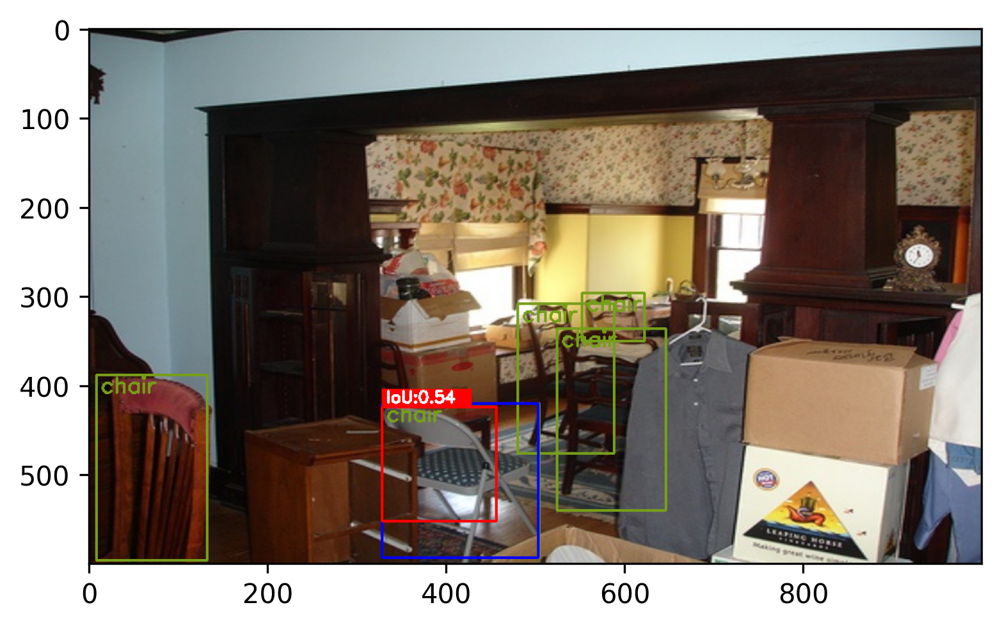

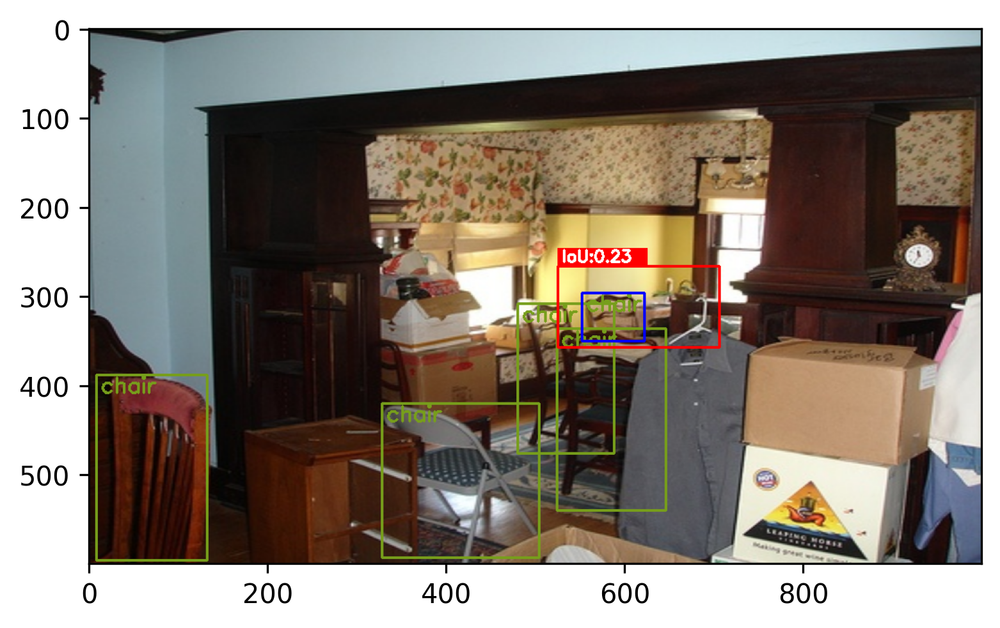

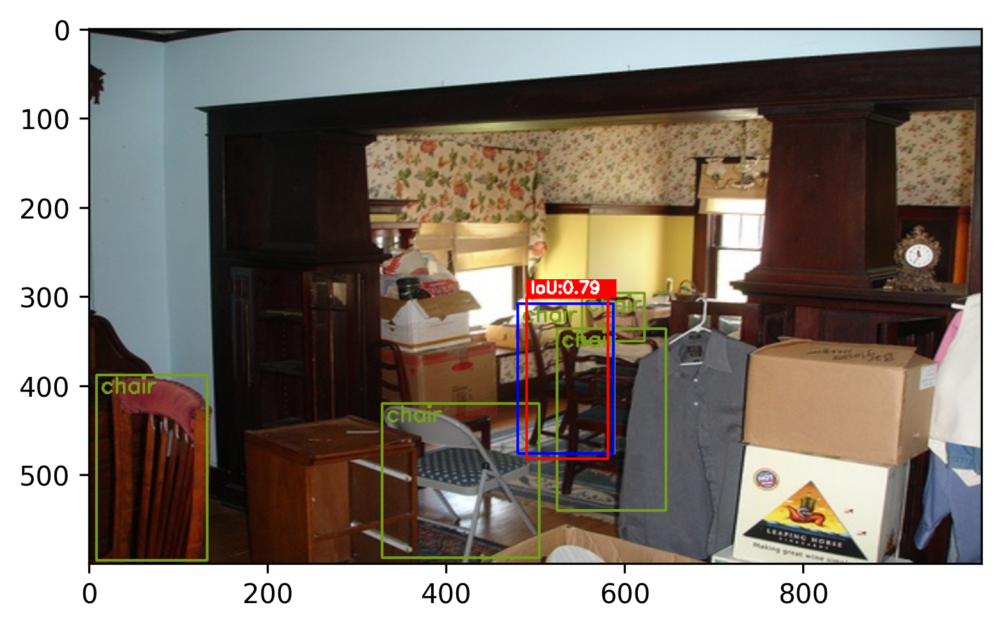

In [2]:
# unparameterize the positive target boxes
rpn_target_boxes = unparameterize_box(
    rpn_reg_target[:rpn_pos_num], anchors[rpn_train_indices[:rpn_pos_num]])

# get pos anchors
pos_anchor_boxes = anchors[rpn_train_indices[:rpn_pos_num]]

# get region proposal target boxes
gt_box_img = train_dataset.draw_label_img(
    img_batch[0],
    gt_cls_ids[0][:num_gt_instance[0]],
    gt_boxes[0][:num_gt_instance[0]])

# show
target_anchor_boxes = zip(rpn_target_boxes, pos_anchor_boxes)
for target_box, anchor_box in target_anchor_boxes:
    iou = box_iou(
        np.expand_dims(target_box, axis=0),
        np.expand_dims(anchor_box, axis=0))[0][0]
    final_image = gt_box_img.copy()
    final_image = draw_box(final_image, target_box, color=[0,0,255])
    final_image = draw_box(final_image, anchor_box, "IoU:{:.2f}".format(iou))
    plt.imshow(final_image)
    plt.show()